# Improved Data Analysis

## Environment Setup

In [1]:
# change to correct working directory
# %pwd
%cd ..
%pwd

/home/felix/bluebird/energy-aware-computing


'/home/felix/bluebird/energy-aware-computing'

In [2]:
# load the auto-reload extension
%load_ext autoreload
%autoreload 2

In [3]:
#!pip3 freeze > pip-freeze.txt

## Imports

In [4]:
import hvplot
import hvplot.pandas
import holoviews as hv
from bokeh.models import HoverTool
from gpyjoules.util import TimestampInfo
from gpyjoules.new_analysis import *
import bokeh.themes
from pathlib import Path
import pandas as pd
import json
import numpy as np
import holoviews as hv
from holoviews import opts
import seaborn as sns


hv.__version__

/home/felix/bluebird/energy-aware-computing/gpyjoules/new_analysis.py:202: SyntaxWarning: 'int' object is not callable; perhaps you missed a comma?
  f_cubic = 6(x, y, kind="nearest")


'1.13.3'

## Global Settings

In [5]:
hv.extension("matplotlib")
#hv.extension("bokeh")
#hv.extension("bokeh", 'matplotlib')
#hv.renderer('bokeh').theme = bokeh.themes.LIGHT_MINIMAL# bokeh.themes.DARK_MINIMAL
#hv.renderer('bokeh').theme = bokeh.themes.DARK_MINIMAL

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

## Load Data

- dgx3: mnist, resnet
- dgx4: nbody(power, clock), bert(long)(power)
- dgx5: bert(short)(power, clock)

In [7]:
loader = DataLoader("data/dgx10")
experiments = loader.experiments
experiments

{'power-limit': Experiment(power-limit)}

In [8]:
#cl_experiment = loader.experiments["clock-limit"]
pl_experiment = loader.experiments["power-limit"]
#cl_experiment,
pl_experiment

Experiment(power-limit)

run = cl_experiment.benchmarks["resnet"].runs["877MHz,1530MHz"]
mean = run.aggregate("hd", "mean")
std = run.aggregate("hd", "std")
low = mean - std
high = mean +std

(hv.Area((mean.data.timestamp, high.data.energy,mean.data.energy),vdims=['y', 'y2']).opts(color= "blue") *
hv.Area((mean.data.timestamp, low.data.energy,mean.data.energy),vdims=['y', 'y2']).opts(color="blue"))


w150 = pl_experiment.benchmarks["resnet"]
means = w150.get_total_values(aggregate=np.mean)


(-((means - means.iloc[4]) ).set_index("timestamp").energy).hvplot()
#means.iloc[4])

## Plots

Select Benchmark and Experiment

In [9]:
b = "bert"
e = "power-limit"
experiment = experiments[e].benchmarks[b]
experiment

Benchmark(bert)

In [10]:
platform = "K80"

(49.915525971403476, 2.1569164363804267, 48.14636494944487, 49.731450169086926, 49.972515116686374, 50.102710556640965)


<ipython-input-11-d27f8823e413>:3: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  title = plt.axes().get_title() + " " + platform


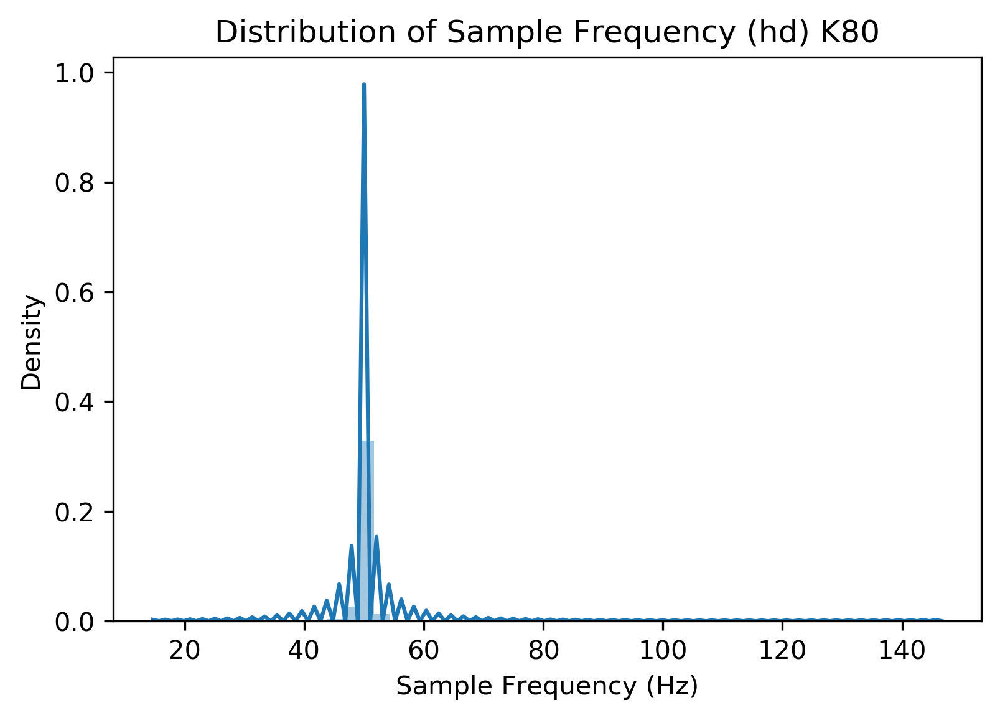

In [11]:
info = loader.plot_sample_frequency_distribution("hd")
print(info)
title = plt.axes().get_title() + " " + platform
plt.title(title)
plt.savefig(f"../master-thesis/images/sample-freq-dist-hd-{platform}.pdf")

<ipython-input-12-8af34297692c>:3: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  title = plt.axes().get_title() + " " + platform


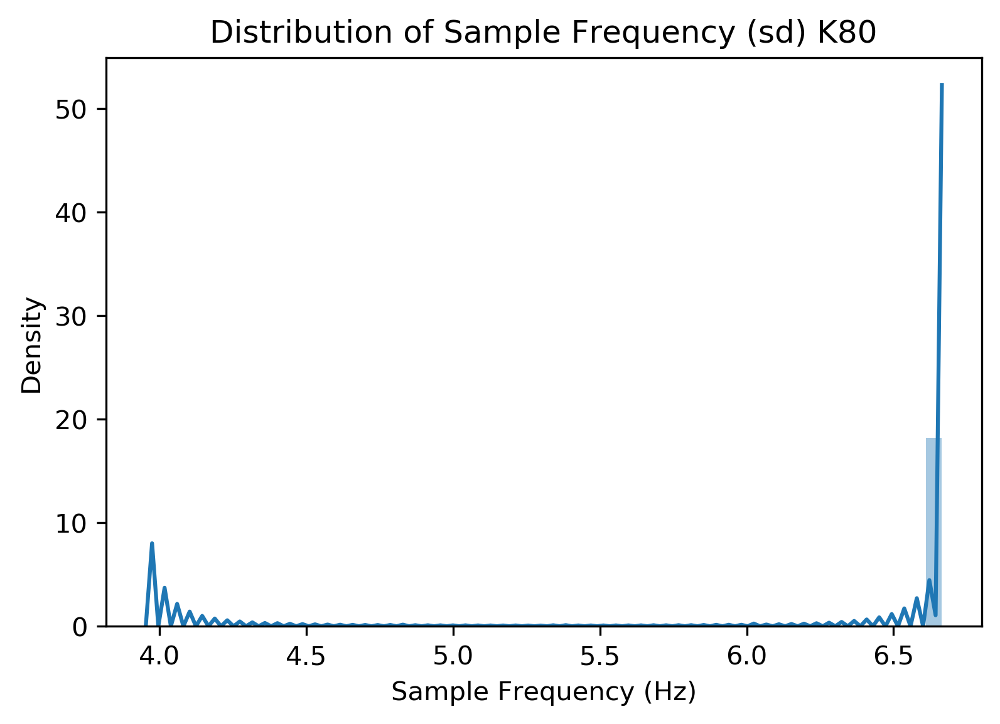

In [12]:
info = loader.plot_sample_frequency_distribution("sd")
#print(info)
title = plt.axes().get_title() + " " + platform
plt.title(title)
plt.savefig(f"../master-thesis/images/sample-freq-dist-sd-{platform}.pdf")

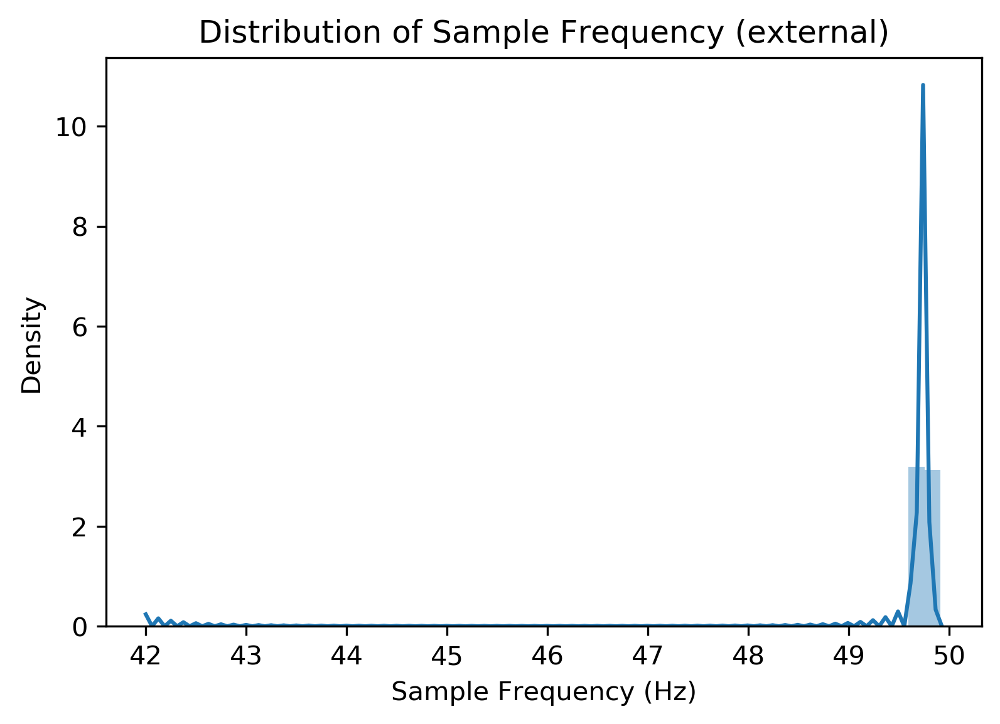

In [13]:
info = loader.plot_sample_frequency_distribution("external")
#print(info)
plt.savefig("../master-thesis/images/sample-freq-dist-external.pdf")

<ipython-input-14-ced0b58286df>:2: RuntimeWarning: divide by zero encountered in true_divide
  sns.distplot(1/np.diff(t))


OverflowError: cannot convert float infinity to integer

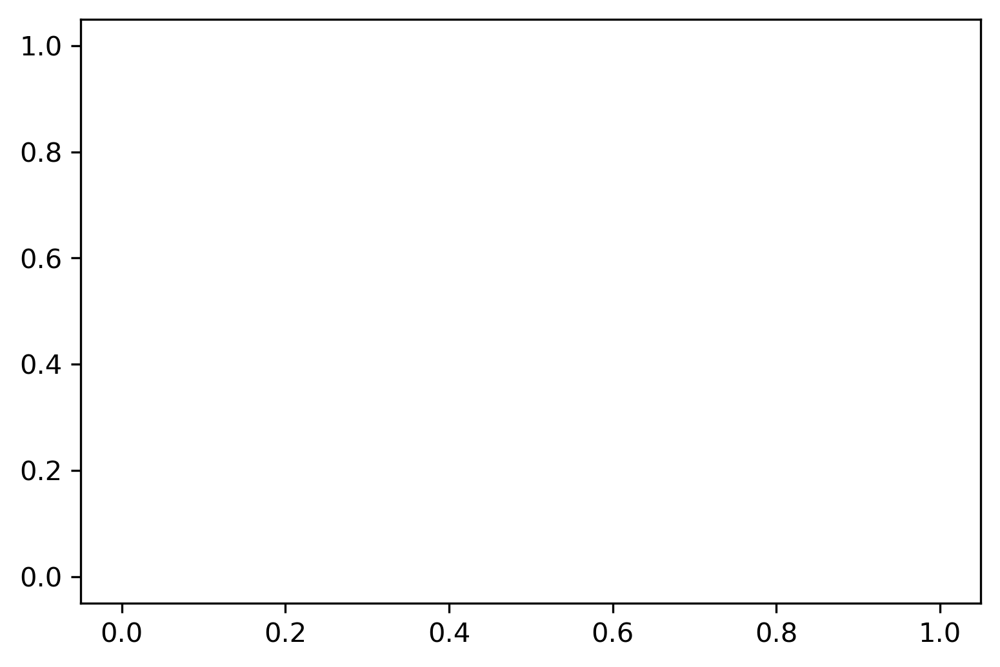

In [14]:
t = loader.get_original_timestamps("hd")
sns.distplot(1/np.diff(t))
import matplotlib.pyplot as plt
plt.title("Distribution of Sample Frequency (sd)")
plt.xlabel("Sample Frequency (Hz)")
plt.ylabel("Density")

In [ ]:
r = experiment.runs['1065MHz']
r = r.repetitions[0]
t = r.measurements["hd"].original_timestamp
sns.distplot(1/np.gradient(t[t>0]))
plt.title("Distribution of Sample Frequency (sd)")
plt.xlabel("Sample Frequency (Hz)")
plt.ylabel("Density")

### Raw Data - Power

In [14]:
#type(experiment.aggregate().hvplot()))

In [15]:
a = experiment.runs["135MHz"]#reppetition[0]
a.repetitions[0].measurements

KeyError: '135MHz'

In [59]:
t4 = DataLoader("data/t4-2")
t4_e = t4.experiments
t4_e

{'power-limit': Experiment(power-limit)}

In [60]:
k80 = DataLoader("data/k80-3/")
k80_e = k80.experiments
k80_e

{'power-limit': Experiment(power-limit)}

In [61]:
dgx = DataLoader("data/dgx10")
dgx_e = dgx.experiments
dgx_e

{'power-limit': Experiment(power-limit)}

In [62]:
b = "bert"
e = "power-limit"

In [63]:
dgx_e[e].benchmarks

{'mnist-dense': Benchmark(mnist-dense),
 'resnet': Benchmark(resnet),
 'mnist-cnn': Benchmark(mnist-cnn),
 'nbody': Benchmark(nbody),
 'bert': Benchmark(bert)}

:Overlay
   .Curve.Mnist_hyphen_minus_dense :Curve   [power]   (clock-gpu)
   .Curve.Resnet                   :Curve   [power]   (clock-gpu)
   .Curve.Mnist_hyphen_minus_cnn   :Curve   [power]   (clock-gpu)
   .Curve.Nbody                    :Curve   [power]   (clock-gpu)
   .Curve.Bert                     :Curve   [power]   (clock-gpu)
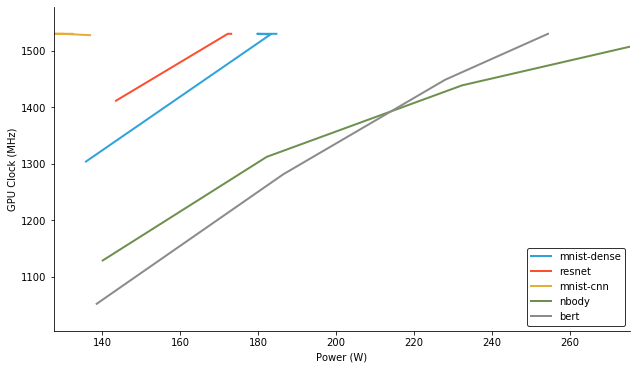

In [64]:
curves = []
for index ,item in dgx_e[e].benchmarks.items():
    agg = item.aggregate()
    agg["perf"] = 1 / agg["timestamp"]
    curves.append(hv.Curve(agg.set_index("power")["clock-gpu"], label=index))

apply_plot_default_settings(overlay_plots(curves))

:Overlay
   .Curve.Mnist_hyphen_minus_dense :Curve   [power]   (clock-gpu)
   .Curve.Resnet                   :Curve   [power]   (clock-gpu)
   .Curve.Mnist_hyphen_minus_cnn   :Curve   [power]   (clock-gpu)
   .Curve.Nbody                    :Curve   [power]   (clock-gpu)
   .Curve.Bert                     :Curve   [power]   (clock-gpu)
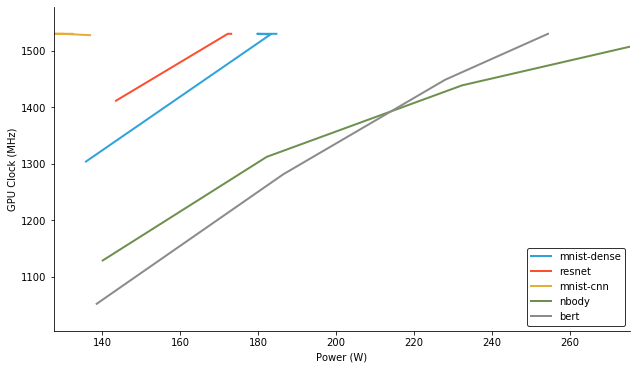

In [65]:

dgx_e[e].benchmarks[b].runs["150W"].repetitions[0].measurements["joined"].data.set_index("power")["clock-gpu"]#.plot() #.plot(metric="clock-gpu") #* k80_e[e].benchmarks[b].plot(metric="energy")
apply_plot_default_settings(hv.Curve(dgx_e[e].benchmarks[b].aggregate().set_index("power")["clock-gpu"]))
curves = []
for a ,b in dgx_e[e].benchmarks.items():
    curves.append(hv.Curve(b.aggregate().set_index("power")["clock-gpu"], label=a))

apply_plot_default_settings(overlay_plots(curves))

:Overlay
   .Curve.Mnist_hyphen_minus_dense :Curve   [power]   (clock-gpu)
   .Curve.Resnet                   :Curve   [power]   (clock-gpu)
   .Curve.Mnist_hyphen_minus_cnn   :Curve   [power]   (clock-gpu)
   .Curve.Nbody                    :Curve   [power]   (clock-gpu)
   .Curve.Bert                     :Curve   [power]   (clock-gpu)
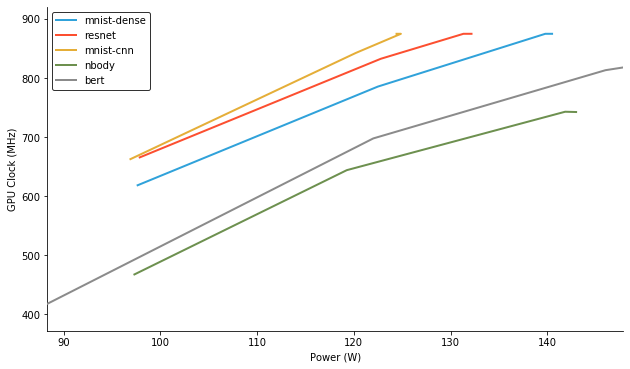

In [66]:
curves = []
for a ,b in k80_e[e].benchmarks.items():
    curves.append(hv.Curve(b.aggregate().set_index("power")["clock-gpu"], label=a))

apply_plot_default_settings(overlay_plots(curves))

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

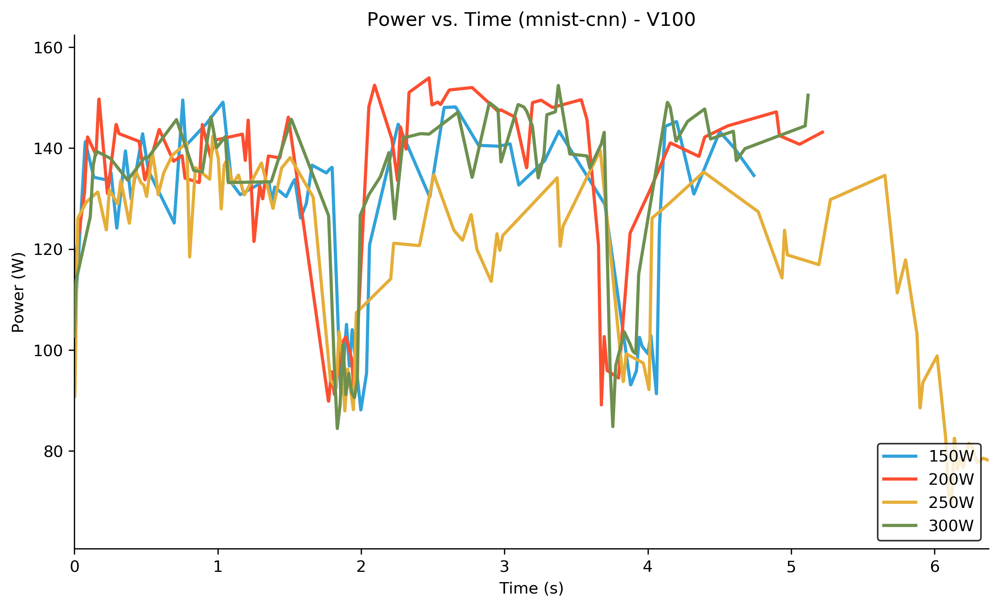

In [67]:
# "proof" for theorem 1
hv.extension('matplotlib')
myplot = dgx_e[e].benchmarks["mnist-cnn"].plot("power", data_slice=0).opts(title="Power vs. Time (mnist-cnn) - V100").opts(aspect=16/9,  show_grid=True)

hv.save(myplot, backend="matplotlib", filename="../master-thesis/images/power-mnist-cnn-v100.pdf",fmt="pdf")
hv.render(myplot, backend="matplotlib")

In [68]:
k80_e[e].loader.clean_name

'K80'

In [69]:
timestamps = pd.read_csv("data/k80-3/power-limit/bert/175W/0/timestamps.csv")
timestamps["timestamp"] = pd.to_datetime(timestamps["timestamp"])
timestamps[(timestamps.event=="epoch_begin") & (timestamps.data==1)]["timestamp"]

4   2020-11-16 13:23:25.995498
Name: timestamp, dtype: datetime64[ns]

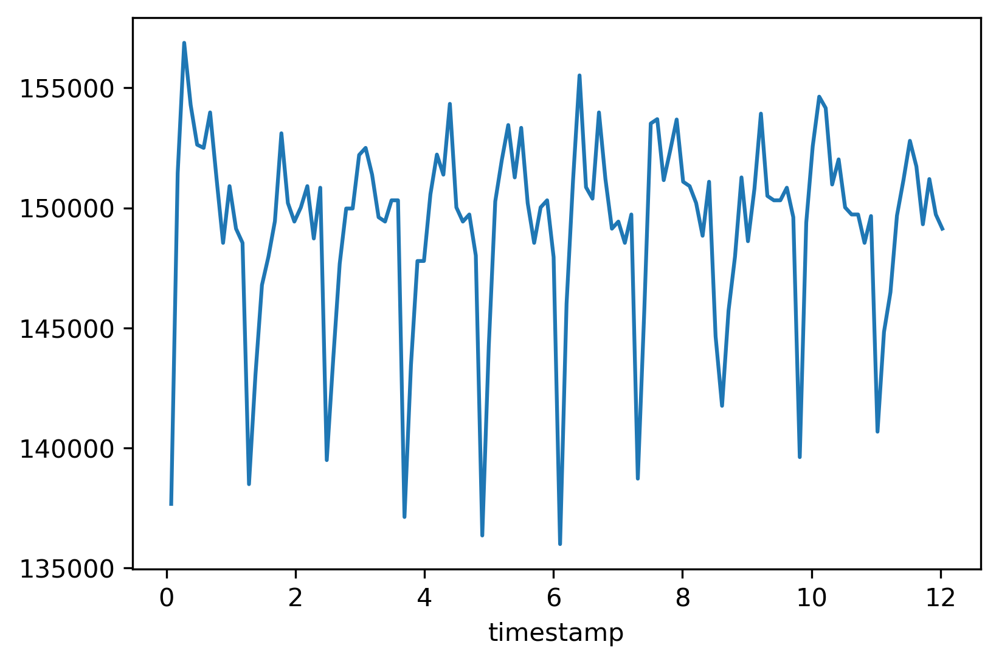

In [70]:
df = pd.read_csv("data/k80-3/power-limit/bert/175W/0/total_power_samples.csv")
df["timestamp"] = (pd.to_datetime(df["timestamp"], unit="us") - timestamps[(timestamps.event=="epoch_begin") & (timestamps.data==1)]["timestamp"].iloc[0])/ np.timedelta64(1, 's') #- k80_e[e].benchmarks["bert"].runs["150W"].repetitions[0].timestamps.get_epoch_begin(1)
df = df[df["timestamp"] >0]
df.set_index("timestamp")["value"].plot()

In [57]:
k80_e[e].benchmarks["bert"].runs["175W"].repetitions[0].timestamps.get_epoch_begin(1), k80_e[e].benchmarks["bert"].runs["175W"].repetitions[0].start_index #.measurements["joined"].data

(Timestamp('2020-11-16 13:23:25.995498'),
 Timestamp('2020-11-16 13:23:25.995498'))

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

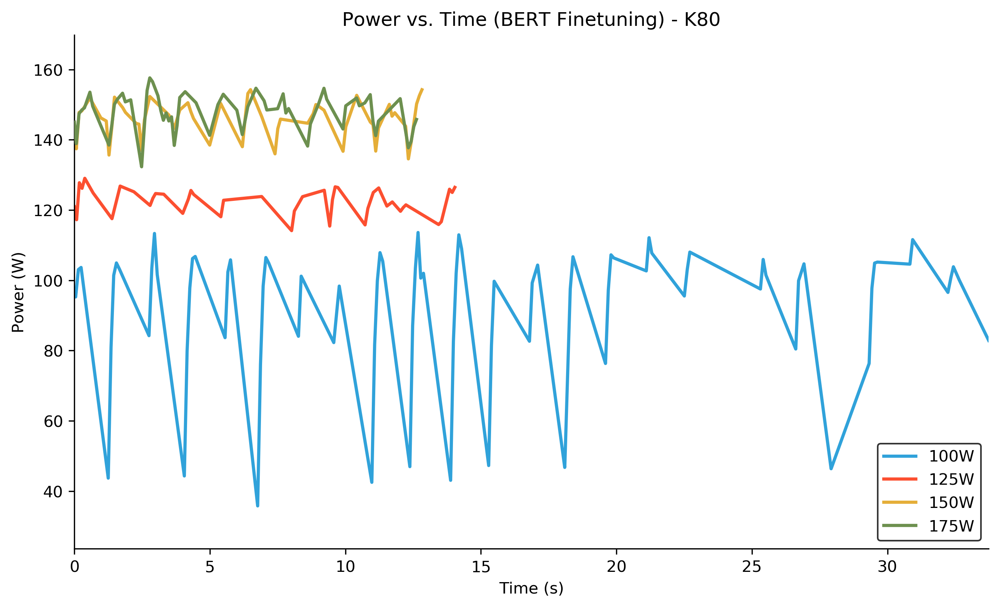

In [71]:
hv.extension('matplotlib')
myplot = k80_e[e].benchmarks["bert"].plot("power", data_slice=1).opts(aspect=16/9,  show_grid=True)

hv.save(myplot, backend="matplotlib", filename="../master-thesis/images/power-bert-k80.pdf",fmt="pdf")
hv.render(myplot, backend="matplotlib")

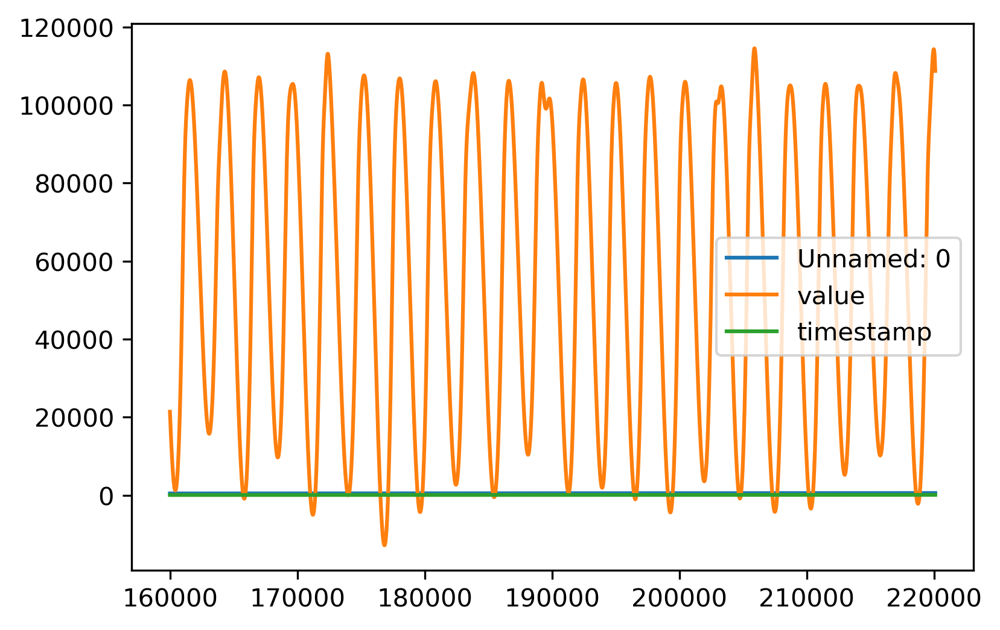

In [134]:
df = pd.read_csv("data/k80-3/power-limit/bert/100W/0/total_power_samples.csv")
df["timestamp"] = pd.to_datetime(df["timestamp"], unit="us")
df["timestamp"] = (df["timestamp"] - df["timestamp"].iloc[0]) / np.timedelta64(1,"s")
#
#(df.set_index("timestamp")["value"] / 1000).plot()
df = interpolate_df(df.set_index("timestamp"),2000)
df = df [df["timestamp"] > 80]
df.plot()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

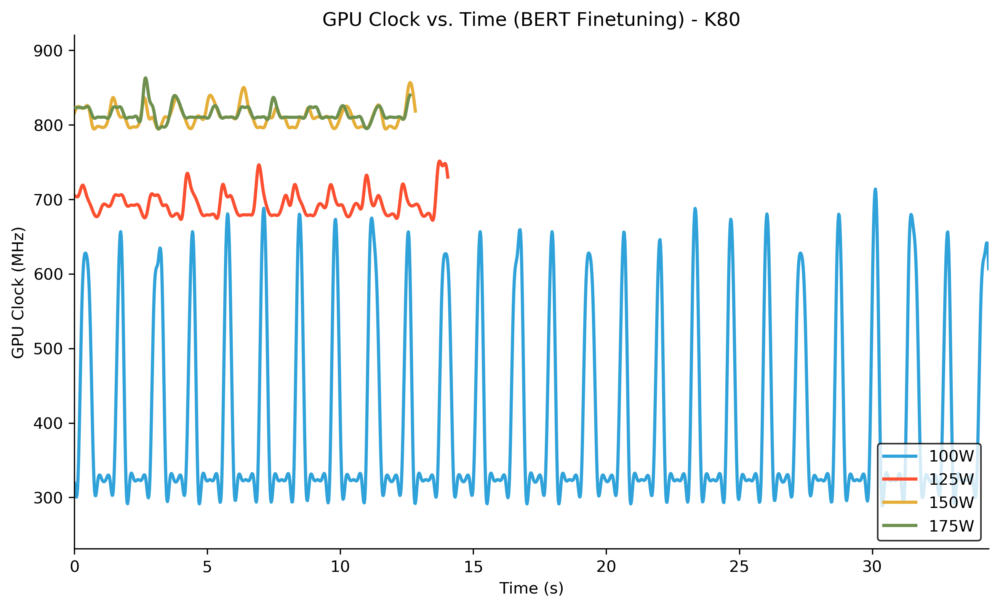

In [107]:
hv.extension('matplotlib')
myplot = k80_e[e].benchmarks["bert"].plot("clock-gpu", data_slice=0).opts(aspect=16/9,  show_grid=True)

hv.save(myplot, backend="matplotlib", filename="../master-thesis/images/clock-bert-k80.pdf",fmt="pdf")
hv.render(myplot, backend="matplotlib")

In [54]:
apply_plot_default_settings(
    k80_e[e].benchmarks["nbody"].plot("power", data_slice=1)
                            * k80_e[e].benchmarks["nbody"].plot("clock-gpu", data_slice=1)
                           ).opts(show_grid=True)

:Overlay
   .Curve.A_100W :Curve   [timestamp]   (power)
   .Curve.A_125W :Curve   [timestamp]   (power)
   .Curve.A_150W :Curve   [timestamp]   (power)
   .Curve.A_175W :Curve   [timestamp]   (power)
   .Curve.I      :Curve   [timestamp]   (clock-gpu)
   .Curve.II     :Curve   [timestamp]   (clock-gpu)
   .Curve.III    :Curve   [timestamp]   (clock-gpu)
   .Curve.IV     :Curve   [timestamp]   (clock-gpu)

:Overlay
   .Curve.A_100W :Curve   [timestamp]   (clock-gpu)
   .Curve.A_125W :Curve   [timestamp]   (clock-gpu)
   .Curve.A_150W :Curve   [timestamp]   (clock-gpu)
   .Curve.A_175W :Curve   [timestamp]   (clock-gpu)
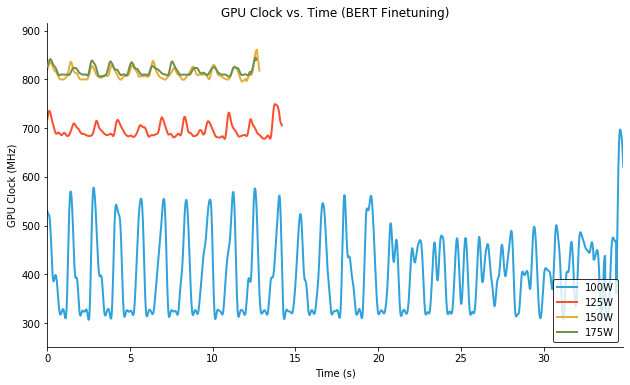

In [61]:
b.aggregate().set_index("power")["clock-gpu"]

power
55.761000     404.105968
123.056322    695.949104
146.965983    812.501050
148.795144    817.377085
Name: clock-gpu, dtype: float64

In [ ]:
2505 
823 810 692 562
324
324

:Overlay
   .Curve.Mnist_hyphen_minus_dense :Curve   [power]   (clock-gpu)
   .Curve.Resnet                   :Curve   [power]   (clock-gpu)
   .Curve.Mnist_hyphen_minus_cnn   :Curve   [power]   (clock-gpu)
   .Curve.Nbody                    :Curve   [power]   (clock-gpu)
   .Curve.Bert                     :Curve   [power]   (clock-gpu)
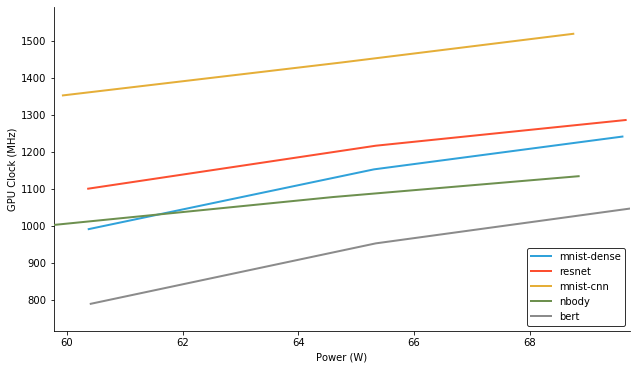

In [51]:
curves = []
for a ,b in t4_e[e].benchmarks.items():
    curves.append(hv.Curve(b.aggregate().set_index("power")["clock-gpu"], label=a))

apply_plot_default_settings(overlay_plots(curves))

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
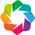

:Overlay
   .Curve.A_100W :Curve   [timestamp]   (power)
   .Curve.A_125W :Curve   [timestamp]   (power)
   .Curve.A_150W :Curve   [timestamp]   (power)
   .Curve.A_175W :Curve   [timestamp]   (power)

In [50]:
#loader.plot(benchmark="bert", metric="clock-gpu")
#plot = experiment.plot(metric="energy")
# stalls auf gpu messen
#plot
hv.extension('bokeh')
b = "bert"
e = "power-limit"
experiment = experiments[e].benchmarks[b]
plot = experiment.plot(metric="power")#, data_source="joined") # + plot
plot#.opts(ylim=(0,20))

In [34]:
experiment.aggregate()

,clock-mem,clock-gpu,app-clock-mem,app-clock-gpu,enforced-power-limit,power-state,tmp,util-gpu,util-mem,power,timestamp,energy,edp
run,,,,,,,,,,,,,
100W,837.839065,387.084827,2505.0,562.0,100000.0,6.112105,49.968638,99.316829,9.912033,66.621239,152.010,10.129312,1539.758168
125W,2499.927118,640.469954,2505.0,562.0,125000.0,0.018608,62.141761,98.809181,2.421250,122.895506,93.745,11.520591,1080.047720
150W,2498.967065,744.405438,2505.0,562.0,150000.0,0.022129,56.028037,98.588045,2.753798,144.233062,80.745,11.646687,940.419018
175W,2499.208138,741.498797,2505.0,562.0,175000.0,0.021245,63.877375,98.749528,2.888740,145.489878,81.620,11.874460,969.298307


In [29]:
df = experiment.runs["150W"].repetitions[0].measurements["external"].data
#df["d0c1"] + df["d0c0"] + df["d1c1"] + df["d1c0"]
df

KeyError: '150W'

In [87]:
experiment.plot(metric="energy", data_source="external")  + experiment.plot(metric="energy", data_source="joined") 

:Layout
   .Overlay.I  :Overlay
      .Curve.A_150W :Curve   [timestamp]   (energy)
      .Curve.A_200W :Curve   [timestamp]   (energy)
      .Curve.A_250W :Curve   [timestamp]   (energy)
      .Curve.A_300W :Curve   [timestamp]   (energy)
   .Overlay.II :Overlay
      .Curve.A_150W :Curve   [timestamp]   (energy)
      .Curve.A_200W :Curve   [timestamp]   (energy)
      .Curve.A_250W :Curve   [timestamp]   (energy)
      .Curve.A_300W :Curve   [timestamp]   (energy)

In [50]:
agg = experiment.aggregate()
agg["inst"] = agg["clock-gpu"] * agg["timestamp"]
display(agg), 1/(agg.loc["150W"]["clock-gpu"] / agg.loc["300W"]["clock-gpu"])
#agg.set_index("clock-gpu")["timestamp"].plot()

,clock-mem,clock-gpu,power-state,tmp,pci-tx,pci-rx,util-gpu,util-mem,power,timestamp,energy,edp,inst
run,,,,,,,,,,,,,
150W,877.0,840.0,0.0,36.900055,56469.051431,449575.106014,81.721156,19.875052,89.217196,12.05,1.075000,12.960948,10122.0
200W,877.0,840.0,0.0,36.561413,51817.458826,381447.467316,82.575417,19.764057,88.135000,11.65,1.028010,11.981187,9786.0
250W,877.0,840.0,0.0,36.784093,51253.147813,376039.977537,82.389122,19.755705,88.120801,11.58,1.020722,11.823760,9727.2
300W,877.0,840.0,0.0,36.904634,54992.484263,392339.315481,82.271798,20.036285,88.763024,11.69,1.037954,12.134811,9819.6


(None, 1.0)

In [31]:
w300=experiment.runs["300W"]
clipped = np.clip(w300.aggregate("hd", "mean").data.power,0, 150)
#clipped.plot()
e_clipped = get_energy(clipped, w300.aggregate("hd", "mean").data.timestamp)
e_clipped[-1]*1.33

6057.988482318791

### Energy Boxplot

In [20]:
import warnings
import matplotlib.cbook
warnings.filterwarnings("ignore",category=matplotlib.cbook.mplDeprecation)

In [33]:
hv.output(fig='svg')
hv

Error: Value 'svg' for key 'fig' not one of ['html', 'auto', 'png']
For help with hv.util.output call help(hv.util.output)


<module 'holoviews' from '/home/felix/projects/energy-aware-computing/venv/lib/python3.8/site-packages/holoviews/__init__.py'>

In [8]:
hv.extension('matplotlib')
plot = experiment.plot("energy").opts(aspect=16/9, fig_bounds=(0, 0, 2, 2), show_grid=True)
hv.save(plot, backend="matplotlib", filename="testplot.pdf",fmt="pdf")
hv.render(plot, backend="matplotlib")
# plot

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

NameError: name 'experiment' is not defined

In [42]:
experiment.plot("power", data_source="external")

:Overlay
   .Curve.A_150W :Curve   [timestamp]   (power)
   .Curve.A_200W :Curve   [timestamp]   (power)
   .Curve.A_250W :Curve   [timestamp]   (power)
   .Curve.A_300W :Curve   [timestamp]   (power)

### EDP Boxplot

In [74]:
baseline_path = exp.path / "_baseline"
external_baseline_path = baseline_path / "power-external.csv"
external_baseline = pd.read_csv(external_baseline_path, index_col=0)

In [2]:
external_baseline["power"] = external_baseline.filter(regex=r"d\dc\d").sum(axis=1)
external_baseline["timestamp"] = pd.to_datetime(external_baseline["timestamp"])
external_baseline["timestamp"] = (external_baseline["timestamp"] - external_baseline["timestamp"].iloc[0]) / np.timedelta64(1, 's')
external_baseline["power"] = external_baseline["power"] * 10
external_baseline["power"] = external_baseline["power"] / 1_000
#external_baseline.drop(columns=r"d\dc\d")
external_baseline.set_index("timestamp")["power"].mean()

NameError: name 'external_baseline' is not defined

:BoxWhisker   [run]   (edp)
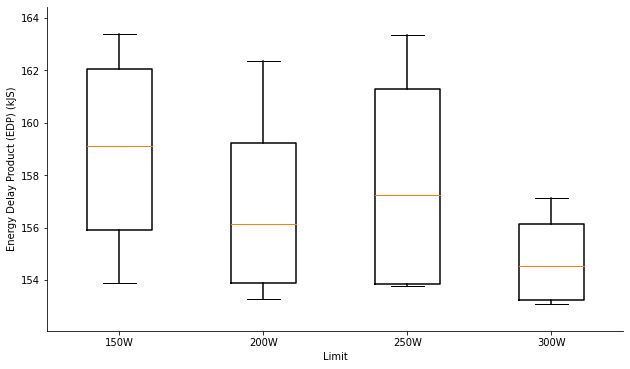

In [36]:
experiment.boxplot("edp")

In [13]:
a = experiment.runs['1005MHz'].repetitions[0]
type(a.start_index)
type(pd.Timestamp(2020))

pandas._libs.tslibs.timestamps.Timestamp

### Combined Boxplot Energy

:Overlay
   .BoxWhisker.I  :BoxWhisker   [run]   (energy)
   .BoxWhisker.II :BoxWhisker   [run]   (energy)
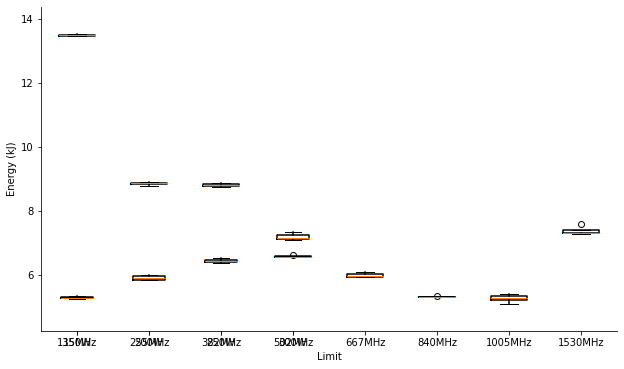

In [31]:
loader.boxplot(b, "energy")

### Cumulative Energy

In [32]:
plots = experiment.plot(metric="energy",data_slice="mean")
# experiment.aggregate()
# ds = hv.Dataset(experiment.aggregate(), "run",  [
#     Dimension("power", label="Power", unit="W"),
#     Dimension("clock-gpu", label="GPU Clock", unit="MHz"),
#     # Dimension("clock", label="GPU Clock", unit="MHz"),
#     Dimension("edp", label="Energy Delay Product (EDP)", unit="kJS"),
#     Dimension("energy", label="Energy", unit="kJ"),
#     Dimension("run", label="Limit"),
#     Dimension("timestamp", label="Time", unit="s"),
# ])
import matplotlib.pyplot as plt
fig = plt.figure()
fig.axes.extend(plots)
plt.show()

<Figure size 1800x1200 with 0 Axes>

In [34]:
ds.to(hv.Curve,"run","timestamp")#.opts(figure.fog=160)

NameError: name 'ds' is not defined

## EDP vs. Energy

In [35]:
apply_plot_default_settings(
hv.Scatter(experiment.plot_totals("timestamp", "energy"))
)

:Scatter   [timestamp]   (energy)

In [36]:
aggregates = loader.aggregate(b).sort_values("clock-gpu")
clock_energy_model = LinearFit(aggregates["clock-gpu"], aggregates.energy,3)
#loader.get_total_values(b,"mean")
print(clock_energy_model)
plot = loader.plot_totals(b, "clock-gpu", "energy") * clock_energy_model.plot()
# plot = plot.opts(title="Energy vs. GPU Clock (BERT Finetuning)")
#hvplot.save(plot, "energy-vs-clock.png", fmt="png")
apply_plot_default_settings(plot)

LinearFit(degree: 3, R2: 1.000, MSE: 0.000)


:Overlay
   .Scatter.I :Scatter   [clock-gpu]   (energy)
   .Curve.I   :Curve   [x]   (y)

:Overlay
   .Scatter.I   :Scatter   [clock-gpu]   (energy)
   .Curve.I     :Curve   [clock-gpu]   (energy)
   .Scatter.II  :Scatter   [clock-gpu]   (edp)
   .Curve.II    :Curve   [clock-gpu]   (edp)
   .Scatter.III :Scatter   [clock-gpu]   (power)
   .Curve.III   :Curve   [clock-gpu]   (power)
   .Scatter.IV  :Scatter   [clock-gpu]   (timestamp)
   .Curve.IV    :Curve   [clock-gpu]   (timestamp)
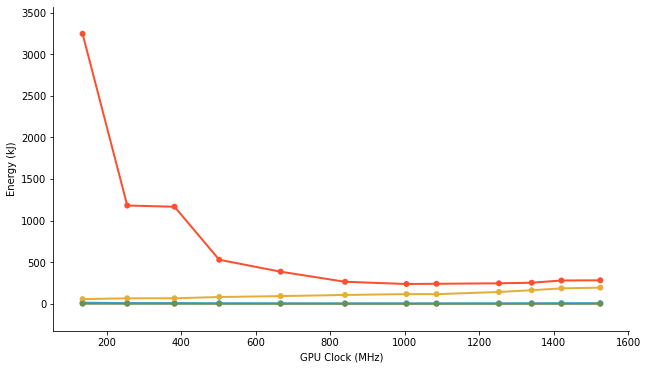

In [80]:
aggregates = loader.aggregate(b).sort_values("clock-gpu")
aggregates["edp"] = aggregates["edp"]# / aggregates["edp"].max()
aggregates["energy"] = aggregates["energy"]# / aggregates["energy"].max()
aggregates["power"] = aggregates["power"] #/ aggregates["power"].max()
aggregates["timestamp"] = aggregates["timestamp"] / aggregates["timestamp"].max()
energy_scatter_plot = hv.Scatter(aggregates.set_index("clock-gpu")["energy"])
edp_scatter_plot = hv.Scatter(aggregates.set_index("clock-gpu")["edp"])
power_sc = hv.Scatter(aggregates.set_index("clock-gpu")["power"])
time_sc = hv.Scatter(aggregates.set_index("clock-gpu")["timestamp"])
apply_plot_default_settings(
    energy_scatter_plot * hv.Curve(energy_scatter_plot) * edp_scatter_plot * hv.Curve(edp_scatter_plot) * power_sc *hv.Curve(power_sc) * time_sc * hv.Curve(time_sc)
)

all_runs = {**experiments["power-limit"].benchmarks[b].runs,
            **experiments["clock-limit"].benchmarks[b].runs
           }

results = []
for key, run in all_runs.items():
    clock_mean = run.aggregate("sd", "mean").data["clock-gpu"].mean()
    power_mean = run.aggregate("hd", "mean").data["power"].mean()
    total_time = run.aggregate("hd", "mean").data["timestamp"].iloc[-1]
    energy = power_mean * total_time
    edp = energy * total_time
    tmp = {
        "clock": clock_mean,
        "energy": energy,
        "edp": edp,
        "power": power_mean
        
    }
    results.append(tmp)

results = pd.DataFrame(results).set_index("clock").sort_index()
results["energy"] = results["energy"] / results["energy"].max()
#results["power"] = results["power"] / results["power"].max()
results["edp"] = results["edp"] / results["edp"].max()
scatter = results["energy"].hvplot.scatter() #* hv.Slope.from_scatter(pd.DataFrame(results).set_index("clock"))
scatter2 = results["edp"].hvplot.scatter()
scatter * hv.Curve(scatter) * scatter2 * hv.Curve(scatter2)

### Clock vs. Power

In [81]:
clock_power_model = LinearFit(aggregates["clock-gpu"], aggregates.power, 2)
clock_power_model
# scheitelpunkt auf 0 forcen

LinearFit(degree: 2, R2: 0.981, MSE: 38.927)

In [82]:
clock_time_model = LinearFit(aggregates["clock-gpu"], aggregates.timestamp, 1, lambda x: 1/x)
clock_time_model

LinearFit(degree: 1, R2: 0.970, MSE: 0.002)

In [37]:
apply_plot_default_settings(
#     hv.Scatter(aggregates.set_index("clock-gpu")["power"])
#     .opts(title="Clock vs. Power") 
#     * clock_power_model.plot()
#    *
    hv.Scatter(aggregates.set_index("clock-gpu")["timestamp"])
        .opts(title="Clock vs. Time") * clock_time_model.plot()
)

NameError: name 'clock_time_model' is not defined

In [98]:
hv.extension("matplotlib")

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

In [99]:
# Make data.
X = np.arange(200, 1500, 50)
Y = np.arange(200, 1500, 50)
X, Y = np.meshgrid(X, Y)
R = clock_time_model.predict(Y) * clock_power_model.predict(X)
#Z = 

surface = hv.Surface(R, bounds=(150, 150, 1550, 1550))


:Surface   [x,y]   (z)
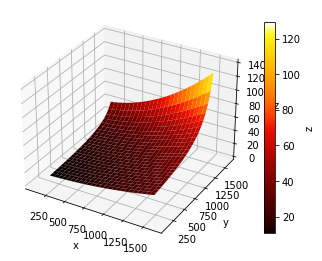

In [100]:
surface.opts(colorbar=True, width=500, height=500)

In [33]:
loader = loader = DataLoader("data/dgx4")
aggregates = loader.aggregate("nbody").sort_values("clock-gpu")

In [34]:
clock_power_model = LinearFit(aggregates["clock-gpu"], aggregates.timestamp,1, lambda x: 1/x)
plot = apply_plot_default_settings(
    aggregates.hvplot.scatter(y="timestamp", x="clock-gpu")
        .opts(title="Time vs. GPU Clock (BERT Finetuning)") 
    * clock_power_model.plot(test_data=(aggregates["clock-gpu"],aggregates["timestamp"])))
plot

:Overlay
   .Scatter.I :Scatter   [clock-gpu]   (timestamp)
   .Curve.I   :Curve   [x]   (y)

In [141]:
clock_power_model

LinearFit(degree: 1, R2: 0.970, MSE: 102.456)

In [62]:
combined = loader.get_total_values(b)
combined= combined.sort_values("clock-gpu")

clock_energy_model = LinearFit(combined["clock-gpu"], combined.edp, 2, np.log )
print(clock_energy_model)
apply_plot_default_settings(
combined.hvplot.scatter(x="clock-gpu", y="edp") * clock_energy_model.plot()
).opts(title="EDP vs. GPU Clock")

LinearFit(degree: 2, R2: 0.970, MSE: 20957.150)


:Overlay
   .Scatter.I :Scatter   [clock-gpu]   (edp)
   .Curve.I   :Curve   [x]   (y)

In [21]:
experiments["power-limit"].benchmarks[b].get_total_values("mean", "joined")

,clock-mem,clock-gpu,power-state,tmp,pci-tx,pci-rx,util-gpu,util-mem,power,timestamp,energy,edp
run,,,,,,,,,,,,
150W,877.0,1116.729679,0.0,43.999975,1362.961706,1130.518975,99.999623,8.137529e-06,148.702458,18.500,2.656857,49.151835
200W,877.0,1300.694330,0.0,47.742593,888.749116,673.403609,100.000001,-1.021732e-08,196.805493,15.425,2.888548,44.555901
250W,877.0,1445.998892,0.0,50.237430,1291.195080,2508.850195,100.000000,0.000000e+00,246.799794,13.890,3.232236,44.896057
300W,877.0,1530.000000,0.0,55.336970,327.970382,-53.390735,100.036900,0.000000e+00,292.593845,13.925,3.769412,52.493101


In [22]:
plots = []
for key, run in experiment.benchmarks["resnet"].runs.items():
    plot = run[0].power_hd.set_index("timestamp").energy.hvplot(label=key)
    plots.append(plot)
    #for epoch in run.timestamps.epochs:
    
    #    plot *= hv.VLine((epoch.begin-run.start_index)/np.timedelta64(1, 's'))
#     if plots is None:
#         plots = plot
#     else:
#         plots *= plot
overlay_plots(plots)

AttributeError: 'Benchmark' object has no attribute 'benchmarks'

In [ ]:
batches = run.timestamps.timestamps[run.timestamps.timestamps["event"] == "batch_begin"].groupby("data").apply(lambda df: df.reset_index(drop=True)).swaplevel(0,1).loc[0]
batches["timestamp"] = (batches["timestamp"] -run.start_index)/np.timedelta64(1, 's')
batches

In [ ]:
plots = None
for key, run in experiment.benchmarks["resnet"].runs.items():
    plot = run.power_hd.set_index("timestamp").power.hvplot(label=key)
    for epoch in run.timestamps.epochs:
        plot *= hv.VLine(run.normalize_timestamp(epoch.begin))
    #plot *= hv.VLine(run.normalize_timestamp(run.timestamps.experiment_begin))
    #for batch in batches.itertuples():
    #    plot *= hv.VLine(batch.timestamp)
    if plots is None:
        plots = plot
    else:
        plots *= plot
plots

- Welche benchmarks?
    - MNIST - keras doku aber abgewandelt -- beispiel für matmul
        - klein -- als negativ beispiel
        - groß  --
        - original messen
    - Resnet - tf/keras doku -- beispiel für conv/resnet
        settings beschreiben
    - Nbody - nvidia cuda examples -- beispiel für hpc
    - Bert - tf/keras doku -- beispiel für ?
    - GPU Burn? -- fehlende cuda version
- Welche Einstellungen?
    - Power limits waren gut
        150 200 250 300 W
    - Clock limits könnten mehr sein
        ca. 10 gleichmäßig verteilt
 
- Woher?
- Wie lange?
- Welche Plots?
    - Rohdaten 
    - Kumulativ Energie
    - Boxplots mit Energie (EDP)
    - EDP vs Energy
    - Clock vs Energy
    - Clock vs Power
    - Clock vs EDP
    - Clock vs Time
    
- Welche Fragen
    - Leitfrage: Kann man mit Power/Clock Limits Energie sparen?
        Ja
    - Unter welchen Umständen? / Bei welchen Netz typen?
        Alle die die GPU gut auslasten
        moderne, große Netze scheinen das alle zu schaffen
    - Wie viel Energie kann gespart werden?
        %
        wovon ist das abhängig?
        Netztyp? Leistungsaufnahme(Baseline)
    - Kann mit Clock Limits noch mehr gespaart werden?
        Wahrscheinlich nicht (wegen hbm ? ) -> andere karten testen; kann nicht hbm sein, weil power geht mit clocks runter wie erwartet (quadratischer fit)
        Powerlimit regelt auch nur clocks
        theoretisch software regler möglich für niedrigere power limits
        hier wären andere karten interessant?
        nochmal lippert fragen?
    
    - Accuracy per Watt?
        Verschiedene netzte eine aufgabe, wer brauch am wenigsten?
        zb. Mnist mit REsnet, Dense Network, decision tree, svm
        bräuchte cpu messung für nicht gpu algorithmen
        
- Externe Messgeräte
    Zum validieren der Messungen von SMI, aber mehr aufwand und gpu nicht isoliert
    
 
- Software Controller
    Wahrscheinlich nicht sinnvoll 


- Docstrings
- pdf plots
- mnist big small conv
- stichpunkte schreiben